In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import nltk

# Installing/loading packages
nltk.download('wordnet')
!pip install plotly_express
!pip install pycountry
!pip install country_converter --upgrade
!pip install wordcloud
!pip install pycountry-convert
!pip install category_encoders
!pip install datatable
!pip install category_encoders
!pip install sklearn-pandas==1.5.0
!pip install textblob
from textblob import TextBlob, Word

[nltk_data] Downloading package wordnet to /home/repl/nltk_data...































































































































[nltk_data]   Unzipping corpora/wordnet.zip.






























































































































































































































































































































































































































































































































     |████████████████████████████████| 9.9 MB 26.1 MB/s            





























































































































































































































































































































































































     |████████████████████████████████| 17

In [ ]:
import pandas as pd

# Load Dataset
data_in=pd.read_csv('data/chocolate_bars.csv')
dataIn=data_in.dropna()
# Splitting the dataset into two seperate datasets. 1 for high quality 1 for low.
lower_quality=dataIn[dataIn['rating']<3.5]
df=dataIn[dataIn['rating']>=3.5]

![chocolate.png](chocolate.png)

<h1 style="color: #0B132B;"><center><u>SNAPSHOTS

<ol type='1'>
<li> Coco bean country of origin <b>does not</b> make a significant difference in chocolate quality</li>
<li>Bars with <b>60-70%</b>coco percentage tend to achieve higher ratings</li>
    <li>Lecithin <b>does not influence</b> the average rating of premium chocolate bars </li>
</oi>

<h1 style="color: #0B132B;"><U><center>INTRODUCTION</U></center></h1>

After a thorough scan of the market, Chocolate Manufacturers & Co. has decided to expand into the Premium Chocolate industry. 
The goal of the current project is to identify potential suppliers of premium chocolate for Chocolate Manufacturers & Co. 
We will answer three broad questions in this analysis;
<ol type='1'>
<li><a href='#question_1'>Does it matter where the cocoa beans come from?</a></li>
    <li><a href='#question_2'>Does cocoa-percentage influence the quality of chocolate bars?</a></li>
    <li><a href='#question_3'>Does the presence of lecithin impact the average rating of bars?</a></li>
</ol>

<h3><a id='question_1' style="color: #731DD8;"><b>Question 1: Does it matter where the beans come from?</b></a></h3>

In answering this question, I will be assessing the average rating of premium chocolate bars (as defined by chocolate bars that achieved ratings higher than 3.5) by bean country of origin. Figure 1 below, maps just this.

We can see that counties that are filled in with darker colours (including Jamaca, Australia, Mexico and several South American countries) achieve the highest ratings. This suggests that the bean country of origin does influence chocolate ratings.

In [ ]:
import country_converter as coco
import pycountry_convert as pc
from contextlib import suppress

# CONVERT COUNTRY TO ISO COUNTRY
cc = coco.CountryConverter()

# Changing country names so that they can be converted to ISO
df.bean_origin=np.where(df.bean_origin=='Sao Tome','Sao Tome and Principe',df.bean_origin )
df.bean_origin=np.where(df.bean_origin=='Principe','Sao Tome and Principe',df.bean_origin )
df.bean_origin=np.where(df.bean_origin=='Sumatra','Indonesia',df.bean_origin )
df.bean_origin=np.where(df.bean_origin=='Sulawesi','Indonesia',df.bean_origin )
# Chnagin blend to 'antarctica' for encoding to ISO, then re-naming 'antarctica' to blend. this will get aaround the error raised
# with cc country convert
df.bean_origin=np.where(df.bean_origin=='Blend','Antarctica',df.bean_origin )

# Create a list of country names for the dataframe
country = []
for name in df['bean_origin']:
    country.append(name)   
    
# Converting country names to ISO 3  
iso_alpha=( cc.convert(names = country, to='ISO3') )
    
# CONVERT ISO COUNTRY TO CONTENENT
def country_to_continent(country_name):
    country_alpha2 = pc.country_name_to_country_alpha2(country_name)
    country_continent_code = pc.country_alpha2_to_continent_code(country_alpha2)
    country_continent_name = pc.convert_continent_code_to_continent_name(country_continent_code)
    return country_continent_name

# converting to contenents
contenent=[]
for iso in iso_alpha:
    try:
        country_name = iso
        contenent.append(country_to_continent(country_name))
    except:
        contenent.append('other')

df['bean_origin_contenent']=contenent
df['bean_origin_ISO']=iso_alpha

# Cre-naming 'antarctica' to blend. this will get aaround the error raised with cc country convert
df.bean_origin_ISO=np.where(df.bean_origin_ISO=='ATA','Blend',df.bean_origin_ISO )
df.bean_origin_contenent=np.where(df.bean_origin_contenent=='ATA','Blend',df.bean_origin_contenent)

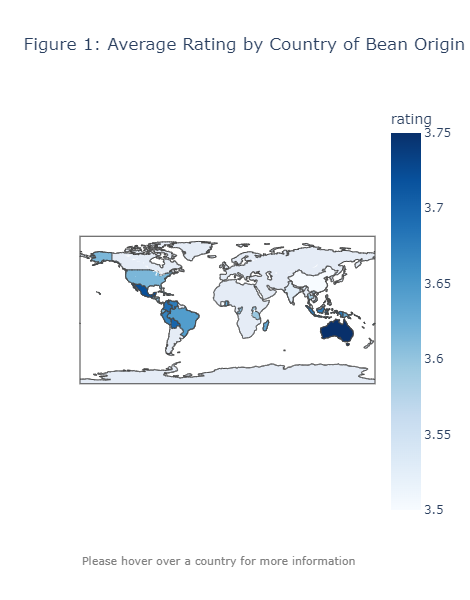

In [ ]:
import plotly.express as px

# Calculating average ratings per group
rating_company = pd.pivot_table(df, values='rating', index=['bean_origin_ISO'],columns=[], aggfunc=np.mean)
Rating_Company = rating_company.reset_index()

# Graphing
fig = px.choropleth(Rating_Company, locations="bean_origin_ISO", color="rating", 
                    hover_name="bean_origin_ISO", 
                    color_continuous_scale="blues", width=700, height=600,
                   title="Figure 1: Average Rating by Country of Bean Origin from 2016 to 2020")
fig.add_annotation(dict(font=dict(color='grey',size=11),x=0,y=-0.12,showarrow=False,
                        text="Please hover over a country for more information",textangle=0,
                        xanchor='left',xref="paper",yref="paper"))
fig.show()

However, when we consider a third variable, the amount of chocolate bars reviewed, a new insight emerges.

Figure 2 displayes a bubble plot in which the amount of chocolate bars reviewed are represented by the size of the bubbles (the larger the bubble, the more chocolate bars reviewed).

When we consider premium and non-premium chocolate, it becomes clear that when a small number of chocolate bars were reviewed, the average score tends to be more extreme (either very-high and very-low). 

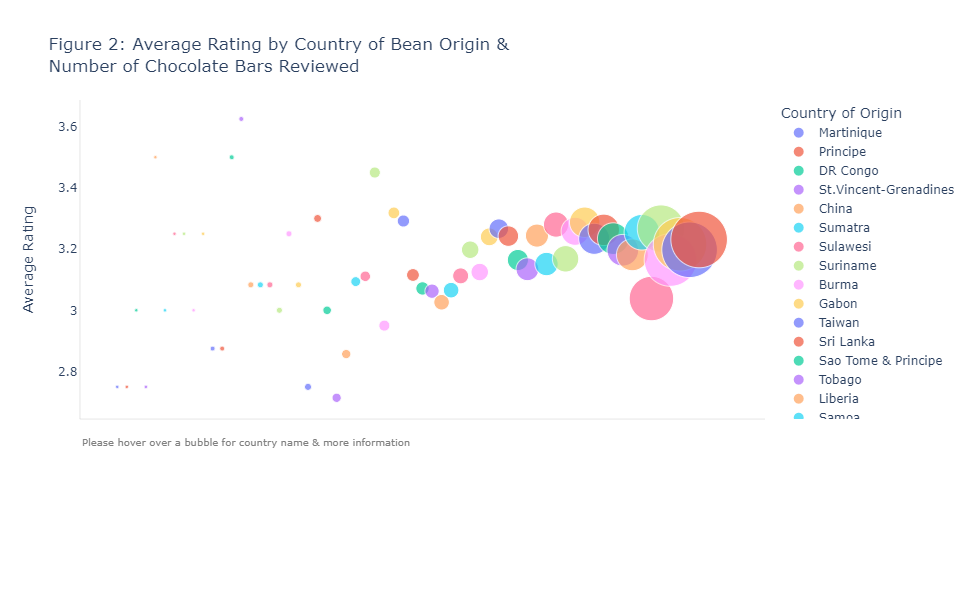

In [ ]:
import datatable as dt
import plotly.express as px

# Calculating average ratings per group
rating_company = pd.pivot_table(data_in, values='rating', index=['bean_origin'],columns=[], aggfunc=np.mean)
Rating_Company = rating_company.reset_index()
d=data_in.groupby('bean_origin').size()    
d2 = d.reset_index()

#Joining the pivot tables
ij = pd.merge(Rating_Company,d2, on ='bean_origin',how='inner')
ij=ij.sort_values(by=[0],ascending=True)
#ij = ij.set_index('bean_origin')
ij= ij.rename(columns={0: "Number of Bars Reviewed"})
ij.head(2)

# Plotting Average Rating by Country of Bean Origin and Number of Chocolate Bars Reviewed
fig = px.scatter(ij, x="bean_origin", y="rating",
                 size="Number of Bars Reviewed", color="bean_origin",
                 hover_name="bean_origin",size_max=40,
                 width=700,height=600, color_continuous_scale="Blues",
                labels={"bean_origin": "Country of Origin",
                     "rating": "Average Rating"},
                title="Figure 2: Average Rating by Country of Bean Origin & <br>Number of Chocolate Bars Reviewed")
fig.update_layout(autosize=False,showlegend=True)
fig.update_xaxes(type='category', tickvals=ij['bean_origin'].tolist(),tickangle=85)
fig.update_xaxes(color='white')
fig.update_layout(autosize=True,showlegend=True, plot_bgcolor='rgba(0,0,0,0)')
fig.update_xaxes(linewidth=0.1, linecolor='black', gridcolor='white')
fig.update_yaxes(linewidth=0.1, linecolor='black', gridcolor='white')
fig.add_annotation(dict(font=dict(color='grey',size=10),x=0,y=-0.10,showarrow=False,
                        text="Please hover over a bubble for country name & more information",textangle=0,
                        xanchor='left',xref="paper",yref="paper"))
fig.show()

In fact, as seen in figure 2 abouve, as the number of chocolate bars reviewed increases, the average score tends to converge to a range between 3.16 to 3.28 (with the exception of mixed bean origin which seems to receive lower than average ratings). 

It may be the case then, that differences in the average rating by county can be explained by low sample sizes (<i>i.e.</i> a small amount of chocolate bars reviewed). 

To further explore this issue, counties will be grouped together into continents; this will avoid situations where there are only a handful of samples from each country. 

This time, we will graph the average ratings of premium chocolates by the <b>continent</b> of bean origin 

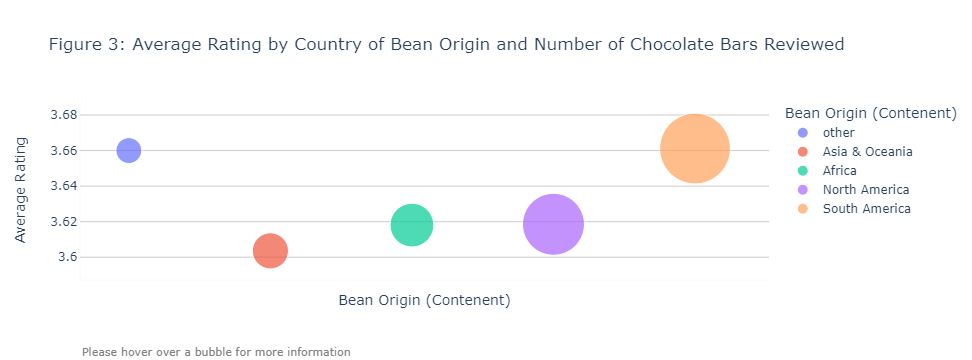

In [ ]:
import plotly.express as px
import datatable as dt

# Combining contenents to make larger groups
df['bean_origin_contenent_2']=df['bean_origin_contenent']
df['bean_origin_contenent_2']=np.where(df['bean_origin_contenent']=='Asia', 'Asia & Oceania',df['bean_origin_contenent_2'])
df['bean_origin_contenent_2']=np.where(df['bean_origin_contenent']=='Oceania', 'Asia & Oceania',df['bean_origin_contenent_2'])

# Calculating average ratings per group
AvgRating_BeanContenent = pd.pivot_table(df, values='rating', index=['bean_origin_contenent'],columns=[], aggfunc=np.mean)
AvgRating_Bean_Contenent=AvgRating_BeanContenent.reset_index()
AvgRating_Bean_Contenent['bean_origin_contenent_2']=AvgRating_Bean_Contenent['bean_origin_contenent']
AvgRating_Bean_Contenent['bean_origin_contenent_2']=np.where(AvgRating_Bean_Contenent['bean_origin_contenent']=='Asia', 'Asia & Oceania',AvgRating_Bean_Contenent['bean_origin_contenent_2'])
AvgRating_Bean_Contenent['bean_origin_contenent_2']=np.where(AvgRating_Bean_Contenent['bean_origin_contenent']=='Oceania', 'Asia & Oceania',AvgRating_Bean_Contenent['bean_origin_contenent_2'])

# Creating a pivot table to show the average rating for each continent
AvgRating_Bean_Contenent_2 = pd.pivot_table(AvgRating_Bean_Contenent, values='rating', index=['bean_origin_contenent_2'],columns=[], aggfunc=np.mean)
AvgRating_Bean_Contenent_2.reset_index()
d= df.groupby('bean_origin_contenent_2').size()    
d3 = d.reset_index()

#Joining the pivot tables
GroupedContenents= pd.merge(AvgRating_Bean_Contenent_2,d3, on ='bean_origin_contenent_2',how='inner')
GroupedContenents=GroupedContenents.sort_values(by=[0],ascending=True)
GroupedContenents = GroupedContenents.set_index('bean_origin_contenent_2')
GroupedContenents= GroupedContenents.rename(columns={0: "Number of Bars Reviewed"})
GroupedContenents=GroupedContenents.reset_index()
# Plotting
fig = px.scatter(GroupedContenents, x="bean_origin_contenent_2", y="rating",
                 size="Number of Bars Reviewed", color="bean_origin_contenent_2",
                 hover_name="bean_origin_contenent_2",size_max=50,
                 width=700,height=300, color_continuous_scale="Blues",
                labels={"bean_origin_contenent_2": "Bean Origin (Contenent)",
                     "rating": "Average Rating"},
                title="Figure 3: Average Rating by Country of Bean Origin and Number of Chocolate Bars Reviewed")
# Fix the layout
fig.update_layout(
    autosize=False,
    #width=1000,
    showlegend=True
)
fig.update_xaxes(type='category', tickvals=df['bean_origin'].tolist())
fig.update_layout(autosize=True,showlegend=True, plot_bgcolor='rgba(0,0,0,0)')
fig.update_xaxes(linewidth=0.1, linecolor='#cccccc', gridcolor='#cccccc')
fig.update_yaxes(linewidth=0.1, linecolor='#cccccc', gridcolor='#cccccc')
fig.add_annotation(dict(font=dict(color='grey',size=11),x=0,y=-0.45,showarrow=False,
                        text="Please hover over a bubble for more information",textangle=0,
                        xanchor='left',xref="paper",yref="paper"))
fig.show()

Figure 3 shows that, on average, beans from South America achieved higher ratings as compared to the other continents of origin, however, the difference is marginal. South America rated the highest with an average rating of 3.66  while Asia & Ocean rated the lowest with an average rating of 3.6.

This evidence suggests that the bean country of origin is not a major factor in determining the chocolate bar quality. However, one more metric will be considered before drawing conclusions.

In order to quantify the magnitude of the relationship between bean country of origin and chocolate rating, a simple linear regression will be used.
The linear regression takes the following form;
<p>
$$
Y_i = \beta_0 + \beta_1 X_i + \epsilon_i
$$
<p>
Where Y<sub>i</sub> = rating and X<sub>i</sub> = bean country of origin.

In [ ]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
import statsmodels.api as sm
import category_encoders as ce
# Defining x and y vars
X=df[['bean_origin_contenent_2']]
y=df[['rating']]

# encoders
encoder = ce.OneHotEncoder(handle_missing='value',handle_unknown='value',use_cat_names=True)
X_final= encoder.fit_transform(X)
# Fit
reg = LinearRegression()
reg.fit(X_final, y)
# calulate R2
r2=reg.score(X_final, y)
# Print Report
print('Consulting the  R-squared measure, bean origin by continent only explains',round(r2,2),'of the variance in chocolate bar quality')

Consulting the  R-squared measure, bean origin by continent only explains 0.02 of the variance in chocolate bar quality


Thus, the answer to the first question is no,<b> bean origin is not a significant driver of quality</b>. 

This is in line with subject matter experts which suggests that the bean genotype, post-harvest treatment (fermentation, drying, rotating etc.) type of the soil and age of cocoa tree are important determinants of coco bean flavor<a href="#footnote-1"><sup>[1]</sup></a><a href="#footnote-1"><sup>[2]</sup></a>.So it is more likely the case that the manufacturing process will be more important in influencing the final quality of chocolate.
___
<p id="footnote-1" style="font-size:10px">[1] Schwan, R. F., &amp; Wheals, A. E. (2010). The microbiology of cocoa fermentation and its role in chocolate quality. Critical Reviews in Food Science and Nutrition, 44(4), 205–221. https://doi.org/10.1080/10408690490464104 </p>
<p id="footnote-2" style="font-size:10px">[2] Kongor, J. E., Hinneh, M., de Walle, D. V., Afoakwa, E. O., Boeckx, P., &amp; Dewettinck, K. (2016). Factors influencing quality variation in cocoa (Theobroma cacao) bean flavour profile — a review. Food Research International, 82, 44–52. https://doi.org/10.1016/j.foodres.2016.01.012 </p>

<h3><a id='question_2'style="color: #731DD8;"><b>Question 2: Does cocoa-percentage influence the quality of chocolate bars?</b></a></h3>

On average chocolate bars that contain around 60-70% cocoa content achieve higher ratings. However, as before, the number of samples for each value of coco-content considered is an issue. For example, there is only one bar with a coco-percent of 57% while there are 1046 bars that contain 70% cocoa. Thus our ability to draw conclusions based on unpopular coco-percentages is limited.

As before, creating larger groups can help us to understand the relationship between coco-percent and average ratings. As seen below in figure 4, coco-percentages between 60-80% achieved higher average ratings. 

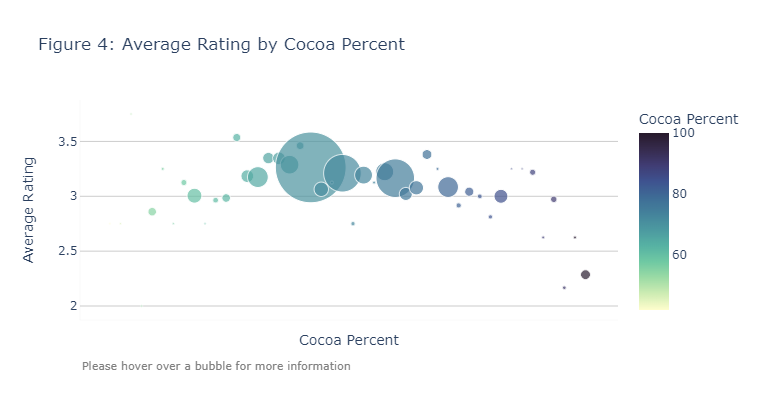

In [ ]:
import datatable as dt
import plotly.express as px

# Calculating average ratings per group
rating_coco = pd.pivot_table(data_in, values='rating', index=['cocoa_percent'],columns=[], aggfunc=np.mean)
ratingCoco = rating_coco.reset_index()

coco_size=data_in.groupby('cocoa_percent').size()    
CocoSize = coco_size.reset_index()

#Joining the pivot tables
Full_cocoa = pd.merge(ratingCoco,CocoSize, on ='cocoa_percent',how='inner')
Full_cocoa=Full_cocoa.sort_values(by=['cocoa_percent'],ascending=True)
Full_cocoa= Full_cocoa.rename(columns={0: "Number of Bars Reviewed"})

# Plotting Data
fig = px.scatter(Full_cocoa, x="cocoa_percent", y="rating",
                 size="Number of Bars Reviewed", color="cocoa_percent",
                 hover_name="cocoa_percent",size_max=50,color_continuous_scale="deep",
                 width=600,height=400,
                 labels={"cocoa_percent": "Cocoa Percent",
                         "rating": "Average Rating"},
                title="Figure 4: Average Rating by Cocoa Percent")
# Fix the layout
fig.update_layout(
    autosize=False,
    width=750,
    showlegend=True
)
fig.update_xaxes(type='category', tickvals=ij['bean_origin'].tolist())
fig.update_layout(autosize=True,showlegend=True, plot_bgcolor='rgba(0,0,0,0)')
fig.update_xaxes(linewidth=0.1, linecolor='#cccccc', gridcolor='#cccccc')
fig.update_yaxes(linewidth=0.1, linecolor='#cccccc', gridcolor='#cccccc')
fig.add_annotation(dict(font=dict(color='grey',size=11),x=0,y=-0.25,showarrow=False,
                        text="Please hover over a bubble for more information",textangle=0,
                        xanchor='left',xref="paper",yref="paper"))
fig.show()

However, as seen in figure 5 below, 589 bars were reviewed that contained 60-70% cocoa, while only 11 bars contained 60% cocoa or less and only 21 contained 80% cocoa or greater.

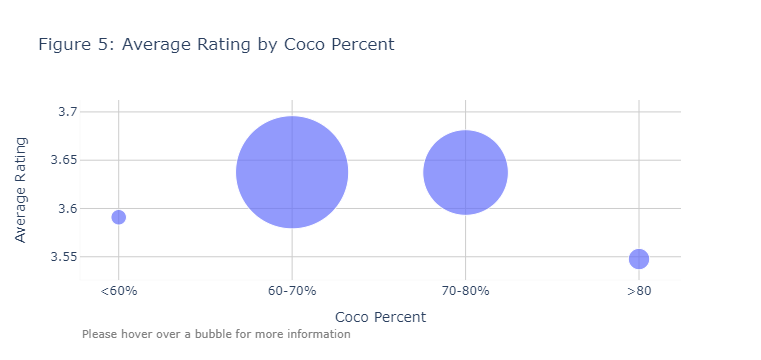

In [ ]:
import seaborn as sns
import plotly.express as px
import datatable as dt

# Creating groups for coco_percent
df['coco_group']=1
df['coco_group']=np.where(df['cocoa_percent']<=60,1,df['coco_group'])
df['coco_group'] = np.where((df['cocoa_percent'] >60)&(df['cocoa_percent'] <= 70), 2,df['coco_group'])
df['coco_group'] = np.where((df['cocoa_percent'] >70)&(df['cocoa_percent'] <= 80), 3,df['coco_group'])
df['coco_group'] = np.where((df['cocoa_percent'] >80)&(df['cocoa_percent'] <= 100), 4,df['coco_group'])
#df['coco_group'] = np.where((df['cocoa_percent'] >90)&(df['cocoa_percent'] <= 100), 5,df['coco_group'])

# Calculating average ratings per group
AvgRating_CocoGroupPivot = pd.pivot_table(df, values='rating', index=['coco_group'],columns=[], aggfunc=np.mean)
AvgRating_CocoGroup=AvgRating_CocoGroupPivot.reset_index()
AvgRating_CocoGroup

# JOIN
cocoGroup=df.groupby('coco_group').size()    
CocoGroup = cocoGroup.reset_index()

#Joining the pivot tables
Co_Co = pd.merge(AvgRating_CocoGroup,CocoGroup, on ='coco_group',how='inner')
Co_Co=Co_Co.sort_values(by=[0],ascending=True)
Co_Co= Co_Co.rename(columns={0: "Number of Bars Reviewed"})

# Graphing

fig = px.scatter(Co_Co, x='coco_group',y='rating', 
                 size="Number of Bars Reviewed", hover_name="coco_group",size_max=80,
                 labels={
                     "coco_group": "Coco Percent",
                     "rating": "Average Rating",
                     },
                title="Figure 5: Average Rating by Coco Percent")
# Fix the layout
fig.update_layout(
    xaxis = dict(
        tickmode = 'array',
        tickvals = [1, 2, 3, 4],
        ticktext = ['<60%', '60-70%', '70-80%', '>80']
    )
)
fig.update_layout(autosize=True,showlegend=True, plot_bgcolor='rgba(0,0,0,0)')
fig.update_xaxes(linewidth=0.1, linecolor='#cccccc', gridcolor='#cccccc')
fig.update_yaxes(linewidth=0.1, linecolor='#cccccc', gridcolor='#cccccc')
fig.add_annotation(dict(font=dict(color='grey',size=11),x=0,y=-0.35,showarrow=False,
                        text="Please hover over a bubble for more information",textangle=0,
                        xanchor='left',xref="paper",yref="paper"))
fig.show()

It may be the case then that chocolate bars within the 60-80% range are more popular with consumers (and therefore more prominent in the sample). This would indicate that new products should contain a coco-percent within this range.

In [ ]:
print('In fact, as seen below, the average coco-content for highly rating chocolate bars is:', round(df['cocoa_percent'].mean()))

In fact, as seen below, the average coco-content for highly rating chocolate bars is: 71


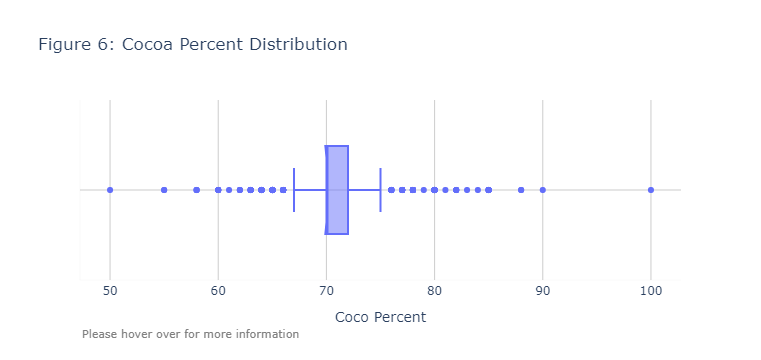

In [ ]:
#What is the average cocoa content for bars with higher ratings (above 3.5)?
# Graphing 
fig = px.box(df, x='cocoa_percent', notched=True,
            labels={"cocoa_percent": "Coco Percent",},
            title="Figure 6: Cocoa Percent Distribution")
# Fix the layout
fig.update_layout(autosize=True,showlegend=True, plot_bgcolor='rgba(0,0,0,0)')
fig.update_xaxes(linewidth=0.1, linecolor='#cccccc', gridcolor='#cccccc')
fig.update_yaxes(linewidth=0.1, linecolor='#cccccc', gridcolor='#cccccc')
fig.add_annotation(dict(font=dict(color='grey',size=11),x=0,y=-0.35,showarrow=False,
                        text="Please hover over for more information",textangle=0,
                        xanchor='left',xref="paper",yref="paper"))
fig.show()

Thus, the answer to the second question is <b>ambiguous</b>. However, it would appear that creating a chocolate bar within the  60-70% cocoa range should be considered. 


<h3><a id='question_3' style="color: #731DD8;"><b>Question 3: Does the presence of lecithin impact the average rating of bars?</b></a></h3>

Research indicates that some consumers want to avoid chocolate bars with lecithin. Inorder to examine this issue, we will consider if the presence of lecithin impacts the average rating of chocolate bars.

If we consider premium chocolates, bars with and without lecithin achieve, on average, similar ratings.

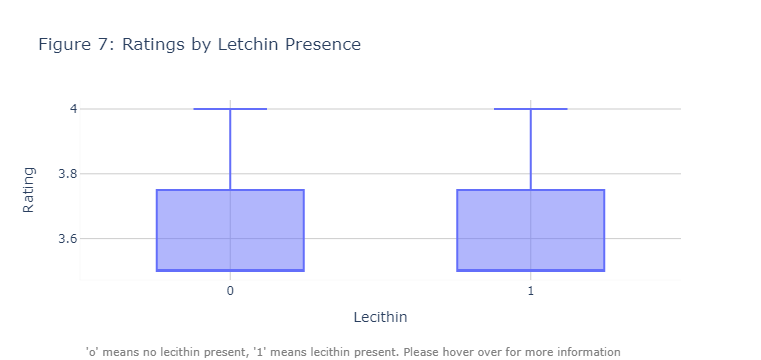

In [ ]:
import plotly.express as px

# Convert Ingredients to dummys; breaking up the ingident column into seperate columns
# the current question is only asking about letchin, but with this further analysis can be done
# to examin the impact of other ingridents such as sugar, or vanilla
df2 = df.join(df['ingredients'].str.get_dummies(sep=',').pipe(lambda x: x*[*x]).replace('',0))
# Convert strings to numbers
df2['B']=np.where(df2['B'],1,df2['B'])
df2['C']=np.where(df2['C'],1,df2['C'])
df2['L']=np.where(df2['L'],1,df2['L'])
df2['S']=np.where(df2['S'],1,df2['S'])
df2['S*']=np.where(df2['S*'],1,df2['S*'])
df2['Sa']=np.where(df2['Sa'],1,df2['Sa'])
df2['V']=np.where(df2['V'],1,df2['V'])

# rename columns
df3= df2.rename(columns={"B": "beans", "C": "cocoa_butter", "L":"lecithin", "S":"sugar", 
                         "S*":"sweetener",'Sa':"salt","V":"vanilla",'year_reviewed':'year','company_location':'country'})
df4=df3.dropna()

# box plot to see the distibution of ratings for bars with and withough letchin
fig = px.box(df4, x='lecithin', y="rating",
             labels={"rating": "Rating","lecithin": "Lecithin"},
             title="Figure 7: Ratings by Letchin Presence")

# Fixing the layout of the graph
fig.update_layout(autosize=True,showlegend=True, plot_bgcolor='rgba(0,0,0,0)')
fig.update_xaxes(linewidth=0.1, linecolor='#cccccc', gridcolor='#cccccc')
fig.update_yaxes(linewidth=0.1, linecolor='#cccccc', gridcolor='#cccccc')
fig.add_annotation(dict(font=dict(color='grey',size=11),x=0,y=-0.45,showarrow=False,
                        text=" 'o' means no lecithin present, '1' means lecithin present. Please hover over for more information",textangle=0,
                        xanchor='left',xref="paper",yref="paper"))
fig.show()

However, when we consider both premium and non-premium chocolate, we can see that bars with lecithin receive a lower average rating.

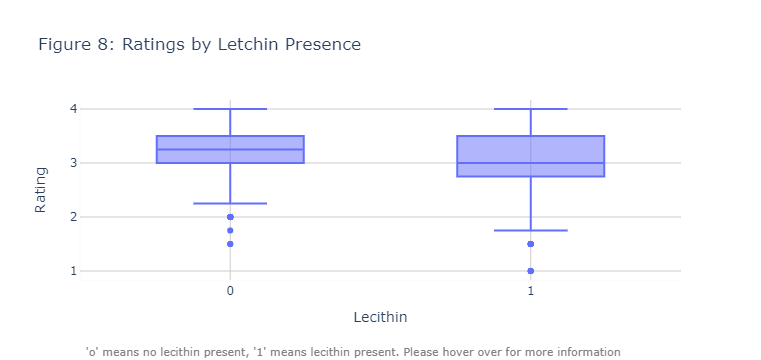

In [ ]:
import plotly.express as px

# Create new column for letchin to identify chocolate bars that contained letchin
data_in['Lecithin']=0
data_in['Lecithin']=np.where((data_in['ingredients'].str.contains("L")), 1, data_in['Lecithin'])

#graphine ratings of chocolate bars with letchin and bars withought letchin
fig = px.box(data_in, x="Lecithin", y="rating",
             labels={"rating": "Rating","lecithin": "Lecithin"},
             title="Figure 8: Ratings by Letchin Presence")
# Fix the layout
fig.update_layout(autosize=True,showlegend=True, plot_bgcolor='rgba(0,0,0,0)')
fig.update_xaxes(linewidth=0.1, linecolor='#cccccc', gridcolor='#cccccc')
fig.update_yaxes(linewidth=0.1, linecolor='#cccccc', gridcolor='#cccccc')
fig.add_annotation(dict(font=dict(color='grey',size=11),x=0,y=-0.45,showarrow=False,
                        text=" 'o' means no lecithin present, '1' means lecithin present. Please hover over for more information",textangle=0,
                        xanchor='left',xref="paper",yref="paper"))
fig.show()

Therefore, to answer our third question, in terms of the premium chocolate market, <b> lecithin does not appear to make a difference in average ratings<b>.


# <u><center> RECOMMENDATIONS 

<ol type='1'>
<li>Cocoa beans from any country can be used </li>
<li>Premium chocolate bars should contain 60-70% cocoa</li>
<li>Lecithin can be included without negative consequence to ratings</li>
</ol>

# <u><center> TECHNICAL ANNEX

### <p style= 'color:#731DD8' > <i> The Data

<li><b> id:</b> id number of the review
<li><b>manufacturer:</b> Name of the bar manufacturer
<li><b>company_location:</b> Location of the manufacturer
<li><b>year_reviewed:</b> From 2006 to 2021
<li><b>bean_origin:</b> Country of origin of the cacao beans
<li><b>bar_name:</b> Name of the chocolate bar
<li><b>cocoa_percent:</b> Cocoa content of the bar (%)
<li><b>num_ingredients:</b> Number of ingredients
<li><b>ingredients:</b> B (Beans), S (Sugar), S* (Sweetener other than sugar or beet sugar), C (Cocoa Butter), (V) Vanilla, (L) Lecithin, (Sa) Salt
<li><b>review:</b> Summary of most memorable characteristics of the chocolate bar
<li><b>rating:</b> 1.0-1.9 Unpleasant, 2.0-2.9 Disappointing, 3.0-3.49 Recommended, 3.5-3.9 Highly Recommended, 4.0-5.0 Oustanding
<p>
    
<b> Acknowledgments</b>: Brady Brelinski, Manhattan Chocolate Society